In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


<IPython.core.display.Javascript object>

In [2]:
import matplotlib.pyplot as plt

%matplotlib inline

<IPython.core.display.Javascript object>

In [3]:
data_path = "../TabulaSapiensData/"

<IPython.core.display.Javascript object>

In [5]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



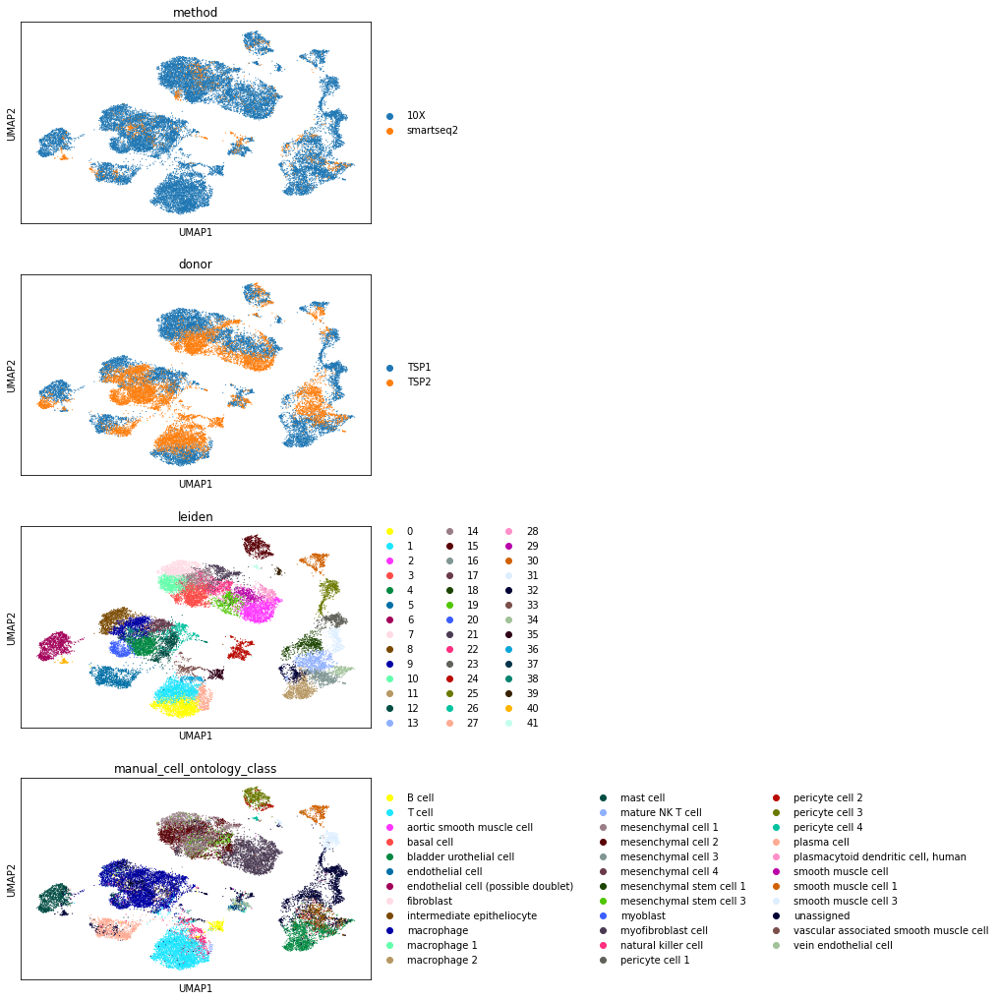

<IPython.core.display.Javascript object>

In [219]:
organ = "Bladder"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [220]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

<IPython.core.display.Javascript object>

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

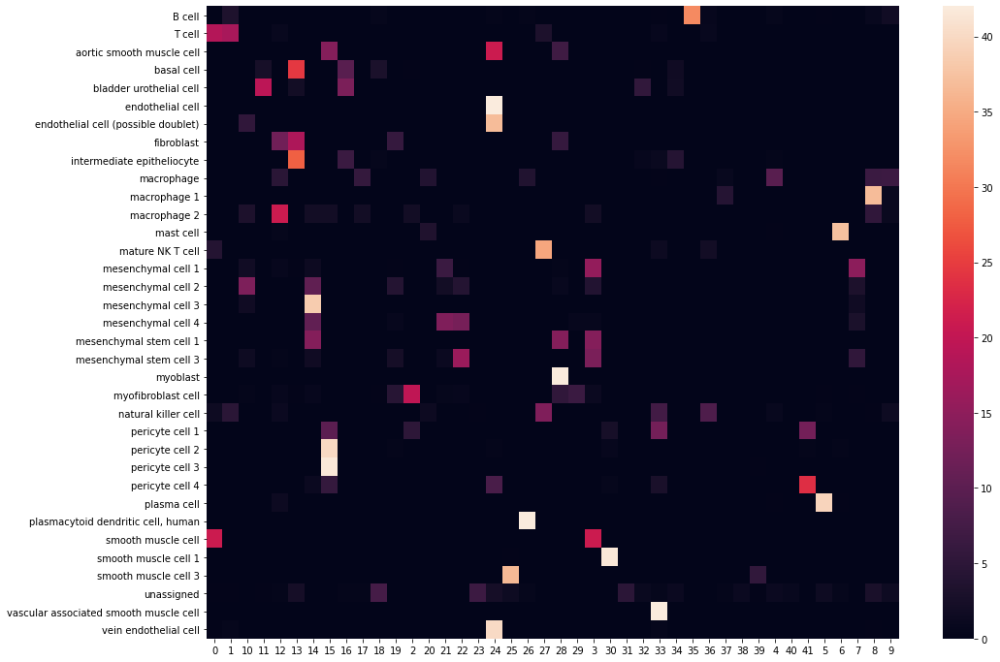

<IPython.core.display.Javascript object>

In [310]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.mean(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [339]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

<IPython.core.display.Javascript object>

In [341]:
cluster_composition["0"]

['T cell: 0.96',
 'macrophage: 0.00',
 'mature NK T cell: 0.00',
 'myofibroblast cell: 0.00',
 'natural killer cell: 0.01',
 'plasma cell: 0.00',
 'smooth muscle cell: 0.00',
 'unassigned: 0.01',
 'vein endothelial cell: 0.00']

<IPython.core.display.Javascript object>

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [221]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

<IPython.core.display.Javascript object>

In [222]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-221-963029a66ab7>:5: RuntimeWarning:

invalid value encountered in long_scalars



<IPython.core.display.Javascript object>

In [223]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

<IPython.core.display.Javascript object>

... storing 'new_manual_cell_ontology_class' as categorical


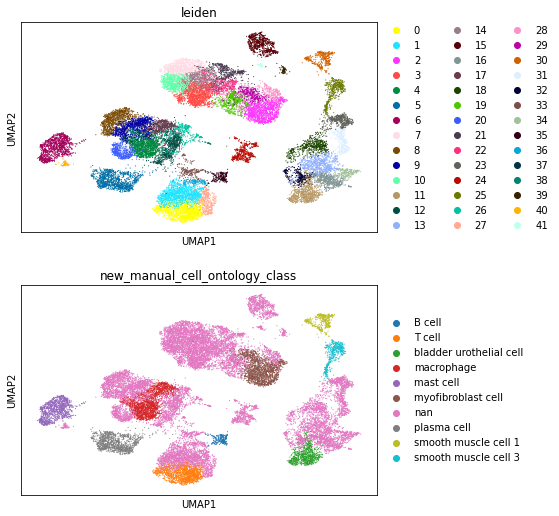

<IPython.core.display.Javascript object>

In [224]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

# Sankey Diagram between cluster and cell types

In [272]:
from utils.colorDict import donor_colors, method_colors, compartment_colors, tissue_colors

<IPython.core.display.Javascript object>

In [369]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

<IPython.core.display.Javascript object>

In [370]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Bladder.html'

<IPython.core.display.Javascript object>

# visualize compartment markers

In [314]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

<IPython.core.display.Javascript object>

In [316]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



<IPython.core.display.Javascript object>

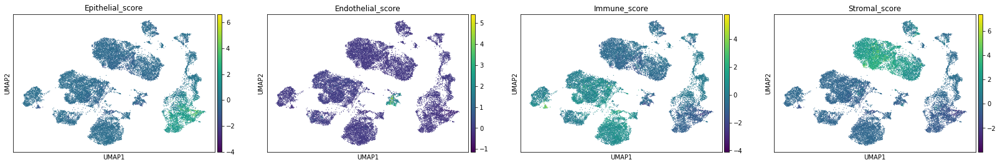

<IPython.core.display.Javascript object>

In [320]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [ ]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

In [ ]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


In [230]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

<IPython.core.display.Javascript object>

### top positive marker genes

In [322]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
CXCR4,52.791164,7.575534,0.000000e+00
CD3D,50.978634,6.333284,0.000000e+00
IL7R,47.952839,7.743592,0.000000e+00
IL32,47.816380,3.756449,0.000000e+00
CD3E,46.534985,4.077493,0.000000e+00
TRAC,45.732502,0.547948,0.000000e+00
CD52,45.536503,1.382264,0.000000e+00
CD2,45.518677,2.618608,0.000000e+00
CD48,44.610909,2.243088,0.000000e+00
TRBC2,41.772491,4.082561,0.000000e+00


1


,wilcoxon_score,log fold change,adjusted pvalue
IL7R,53.296753,21.623211,0.000000e+00
CD2,48.713593,5.563311,0.000000e+00
IL32,47.788006,7.513137,0.000000e+00
CD3D,47.621906,4.500534,0.000000e+00
CXCR4,47.415035,4.724432,0.000000e+00
PTPRC,45.984833,4.081934,0.000000e+00
CD3E,43.631294,4.472280,0.000000e+00
CYTIP,42.764408,-4.339845,0.000000e+00
CD69,42.190266,-54.349411,0.000000e+00
LEPROTL1,41.528965,2.805876,0.000000e+00


2


,wilcoxon_score,log fold change,adjusted pvalue
PLAT,50.374001,55.577068,0.0
A2M,48.841503,70.710114,0.0
F3,46.053120,26.935682,0.0
ITGA8,45.922016,6.112949,0.0
PDGFRA,45.608696,15.517053,0.0
MFAP4,45.148750,98.043861,0.0
TRPA1,44.648823,9.723465,0.0
COL3A1,44.191509,14.271537,0.0
PDPN,44.046383,10.022086,0.0
LUM,42.968227,52.034496,0.0


3


,wilcoxon_score,log fold change,adjusted pvalue
FSTL1,53.577618,49.309872,0.0
DCN,52.437584,353.345917,0.0
GPX3,52.419544,243.626068,0.0
ABI3BP,51.278610,19.599310,0.0
NID1,51.190994,14.116172,0.0
COL6A1,51.072865,40.092762,0.0
COL6A3,50.840839,31.179382,0.0
SCARA5,50.839069,18.885740,0.0
CCDC80,50.702763,37.285046,0.0
MGP,50.581684,304.457794,0.0


4


,wilcoxon_score,log fold change,adjusted pvalue
CD163,50.856544,72.629402,0.0
CTSB,48.743946,163.433456,0.0
FCER1G,48.518993,79.062782,0.0
S100A9,47.096516,81.977982,0.0
FCGR3A,46.871326,15.402438,0.0
AIF1,46.397469,24.988342,0.0
MARCO,46.051441,38.908329,0.0
S100A8,45.669186,46.057095,0.0
LAPTM5,45.404507,25.502571,0.0
TYROBP,44.989815,32.355656,0.0


5


,wilcoxon_score,log fold change,adjusted pvalue
MZB1,54.412777,568.907349,0.0
JCHAIN,53.375854,inf,0.0
DERL3,53.114212,134.639297,0.0
SSR4,53.000477,688.658997,0.0
SEC11C,52.787781,357.709991,0.0
FKBP11,50.354790,202.368362,0.0
IGHA1,50.261364,inf,0.0
IGKC,50.045891,inf,0.0
ISG20,49.698753,81.174828,0.0
SPCS2,45.866398,119.064545,0.0


6


,wilcoxon_score,log fold change,adjusted pvalue
TPSAB1,54.900295,262.873077,0.000000e+00
TPSB2,54.789795,172.949417,0.000000e+00
CPA3,52.943806,157.406281,0.000000e+00
HPGDS,51.969418,210.041016,0.000000e+00
RHEX,46.912159,181.781982,0.000000e+00
MS4A2,46.782158,42.723537,0.000000e+00
IL1RL1,43.577774,55.451675,0.000000e+00
ALOX5AP,42.932377,112.152596,0.000000e+00
KIT,41.667370,43.029579,0.000000e+00
VWA5A,40.675571,37.571102,0.000000e+00


7


,wilcoxon_score,log fold change,adjusted pvalue
PCOLCE2,47.393047,62.929062,0.0
GSN,46.815235,200.050308,0.0
CFD,46.732933,484.642914,0.0
MFAP5,45.116787,68.114288,0.0
IGFBP6,44.689690,128.020752,0.0
FBLN2,44.002930,15.879323,0.0
PRELP,43.178905,13.937410,0.0
FBN1,43.106552,15.894048,0.0
SCARA5,42.395164,11.701627,0.0
PLA2G2A,42.080456,391.113678,0.0


8


,wilcoxon_score,log fold change,adjusted pvalue
F13A1,45.764652,195.776062,0.000000e+00
FOLR2,45.265438,61.370174,0.000000e+00
RNASE1,45.212013,287.727386,0.000000e+00
C1QA,44.975712,59.473545,0.000000e+00
STAB1,44.685287,16.441904,0.000000e+00
C1QC,44.656044,20.687103,0.000000e+00
SELENOP,44.537460,59.261383,0.000000e+00
C1QB,43.856964,64.568794,0.000000e+00
MRC1,43.273766,10.116061,0.000000e+00
LYVE1,43.110146,37.112698,0.000000e+00


9


,wilcoxon_score,log fold change,adjusted pvalue
CD163,40.995831,70.992012,0.000000e+00
MS4A6A,40.535820,69.024796,0.000000e+00
RNASE1,39.652637,312.101593,0.000000e+00
LYZ,38.589611,58.032570,0.000000e+00
TYROBP,38.144318,90.250793,0.000000e+00
C5AR1,37.383682,27.136578,7.059681e-302
MS4A7,37.021275,41.212582,4.379770e-296
VSIG4,37.014694,43.669136,4.890378e-296
F13A1,36.949913,116.237946,4.779656e-295
AIF1,35.893211,52.707924,2.294885e-278


10


,wilcoxon_score,log fold change,adjusted pvalue
DPT,41.484978,5.472826,0.000000e+00
SFRP2,41.276371,22.287554,0.000000e+00
MGP,40.868633,135.182709,0.000000e+00
FBLN1,40.001911,65.044540,0.000000e+00
GSN,39.727089,92.165871,0.000000e+00
PRELP,38.746204,5.703887,0.000000e+00
CFD,38.661659,169.939072,0.000000e+00
CCN5,38.477165,12.568757,0.000000e+00
HTRA1,38.417248,5.537939,0.000000e+00
SERPINF1,38.167282,6.522037,0.000000e+00


11


,wilcoxon_score,log fold change,adjusted pvalue
IGFBP2,43.982414,32.474018,0.0
MIR205HG,43.424496,16.077539,0.0
DHRS2,43.303207,127.606743,0.0
AQP3,43.289806,57.354168,0.0
KRT18,43.151630,61.528824,0.0
KRT19,43.151516,542.742065,0.0
KRT13,43.131836,168.879883,0.0
SFN,43.078178,38.491779,0.0
TACSTD2,42.782009,74.593964,0.0
KRT8,42.657169,38.109112,0.0


12


,wilcoxon_score,log fold change,adjusted pvalue
PTPRC,31.460604,10.730062,1.769664e-212
SRGN,31.403545,16.497324,5.327848e-212
CXCR4,31.028322,14.279518,4.390498e-207
FYB1,30.794594,6.689661,4.556003e-204
LCP1,30.018620,4.038545,6.604169e-194
GPR183,29.927505,14.449819,8.472193e-193
SAMSN1,29.240637,1.006651,4.967424e-184
LAPTM5,29.119215,-6.256189,1.508925e-182
IL7R,29.103706,22.444122,2.107803e-182
TNFAIP3,28.601625,21.423399,3.775520e-176


13


,wilcoxon_score,log fold change,adjusted pvalue
PSCA,39.983856,inf,0.000000e+00
ELF3,39.561935,142.714188,0.000000e+00
LCN2,39.452656,inf,0.000000e+00
S100P,39.452309,238.293060,0.000000e+00
GPX2,39.052361,209.656952,0.000000e+00
SPINK1,38.951801,197.865936,0.000000e+00
CLDN4,38.669449,316.476929,0.000000e+00
TACSTD2,38.593864,183.612686,0.000000e+00
KRT19,38.260708,524.203674,0.000000e+00
KRT7,38.030468,201.329834,0.000000e+00


14


,wilcoxon_score,log fold change,adjusted pvalue
MGP,36.424385,inf,1.030633e-285
GSN,35.203163,344.841339,5.265112e-267
APOD,34.305511,697.060608,1.274386e-253
SFRP2,34.058563,189.225433,4.461703e-250
CFD,32.862789,694.011414,8.806418e-233
IGFBP6,32.679379,218.121658,3.008747e-230
SOCS3,32.476868,67.237411,1.902616e-227
C3,32.412312,590.957031,1.354738e-226
SERPINF1,32.204666,448.722595,9.932657e-224
C1R,31.991190,194.452911,8.511647e-221


15


,wilcoxon_score,log fold change,adjusted pvalue
TAGLN,42.133499,504.551361,0.000000e+00
ACTA2,42.085625,inf,0.000000e+00
MYL9,41.554855,66.748253,0.000000e+00
TPM2,40.596684,320.998138,0.000000e+00
AP002956.1,39.420643,58.308872,0.000000e+00
C11orf96,38.543491,130.738831,0.000000e+00
IGFBP7,37.530846,235.305771,2.433124e-304
PPP1R14A,37.521347,43.545612,3.041639e-304
NOTCH3,37.414455,11.306435,1.487773e-302
CAV1,37.392220,44.764454,3.077743e-302


16


,wilcoxon_score,log fold change,adjusted pvalue
GPX2,41.450500,107.112877,0.0
S100P,41.174618,278.197418,0.0
KRT19,41.100937,695.624329,0.0
TSPAN1,41.007015,74.279190,0.0
AGR2,40.993820,120.682922,0.0
CDC42EP5,40.975483,30.967409,0.0
TACSTD2,40.937817,117.785683,0.0
CLDN7,40.760479,26.821741,0.0
CSTB,40.724602,202.330276,0.0
KRT18,40.674042,126.447319,0.0


17


,wilcoxon_score,log fold change,adjusted pvalue
EREG,39.134354,100.938232,0.000000e+00
IL1B,39.051533,302.957001,0.000000e+00
AIF1,38.509068,29.950594,0.000000e+00
FCN1,38.044094,21.841213,0.000000e+00
LST1,37.942802,10.337398,0.000000e+00
C5AR1,37.453709,21.309872,5.128788e-303
BCL2A1,36.743328,44.998436,1.249581e-291
ITGB2,36.701969,15.092290,4.999332e-291
S100A9,36.452759,124.585968,4.069317e-287
TNFRSF1B,36.287144,14.604499,1.519270e-284


18


,wilcoxon_score,log fold change,adjusted pvalue
MT-RNR1,29.531071,inf,2.706747e-188
MT-ND5,28.596340,395.314514,8.446512e-177
ELF3,28.532579,62.052757,5.132979e-176
MT-RNR2,27.000927,NaN,9.533604e-158
MTND1P23,25.761337,59.387451,1.200384e-143
PSCA,25.008028,7.999429,2.180327e-135
KRT19,24.748617,-58.366539,1.284903e-132
MT-ND2,24.284908,336.853973,1.034846e-127
LCN2,23.718948,-21.043274,7.276203e-122
MT-ATP6,23.528812,inf,6.376891e-120


19


,wilcoxon_score,log fold change,adjusted pvalue
PDPN,35.569965,24.455343,2.403523e-272
LUM,35.222801,168.394180,2.635179e-267
SOD3,34.518799,49.517975,8.223393e-257
TMEM176A,34.424690,19.915434,1.585476e-255
RARRES2,34.319515,32.950268,4.727327e-254
CFH,34.109219,33.074070,5.283250e-251
TMEM176B,33.832333,21.276255,5.552525e-247
COL3A1,33.710266,60.091274,3.008765e-245
COL6A1,33.531734,30.391836,1.087299e-242
NR2F1,33.431053,10.271976,2.856921e-241


20


,wilcoxon_score,log fold change,adjusted pvalue
S100A8,37.239990,128.138458,9.058403e-299
S100A9,36.615189,218.474792,4.825769e-289
LYZ,35.691490,35.990318,1.051359e-274
VCAN,34.959045,22.074213,1.388843e-263
GCA,33.701595,5.294991,6.449445e-245
FPR1,32.562206,4.936199,1.380210e-228
HSPA1A,32.436676,74.404755,7.021390e-227
AC020656.1,32.225410,6.039413,5.724008e-224
S100A12,32.100094,13.166038,2.875355e-222
BCL2A1,32.029068,5.455293,2.528917e-221


21


,wilcoxon_score,log fold change,adjusted pvalue
ADH1B,27.834824,119.420029,9.680666e-166
MGP,27.457270,inf,1.674623e-161
DCN,26.594584,inf,1.538802e-151
IGFBP6,26.096331,62.654285,5.905864e-146
GPX3,24.678879,300.247620,2.122956e-130
C1R,24.326855,85.709251,1.000052e-126
COL1A2,24.279760,116.461197,2.697645e-126
SFRP2,24.092102,77.892235,2.225835e-124
OGN,24.057318,19.334023,4.577659e-124
EFEMP1,23.643166,124.653519,8.169516e-120


22


,wilcoxon_score,log fold change,adjusted pvalue
PLA2G2A,35.240459,inf,2.506593e-267
IGFBP4,35.224220,210.890366,2.506593e-267
PCOLCE,33.670078,242.728439,2.944955e-244
EFEMP1,33.663166,912.550415,2.944955e-244
PLAC9,33.503384,84.624985,5.065929e-242
COL1A2,33.446529,465.337860,2.836453e-241
SERPINF1,33.314796,inf,1.982840e-239
COL6A2,33.287815,101.311432,4.264076e-239
C1R,33.231277,678.455139,2.489450e-238
COL1A1,32.861111,304.784454,4.653195e-233


23


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND3,32.730392,inf,8.496395e-232
MT-ATP6,32.573002,inf,1.239198e-229
MT-RNR1,32.480602,inf,2.144796e-228
MTATP6P1,32.441883,325.524841,7.156370e-228
MT-RNR2,32.385231,NaN,4.075626e-227
MT-ND1,32.085327,753.746277,5.471837e-223
MT-ND4,32.064770,inf,1.031502e-222
MT-ND2,31.702883,342.832336,8.785974e-218
MT-CYB,31.674292,inf,2.131228e-217
MT-ND5,31.661207,277.585510,3.098894e-217


24


,wilcoxon_score,log fold change,adjusted pvalue
CLDN5,30.981794,184.341431,5.582329e-206
GNG11,30.836945,101.843735,2.467417e-204
PECAM1,30.691200,202.475494,1.463651e-202
ECSCR,30.320185,119.699585,9.144713e-198
TM4SF1,29.674095,344.143066,1.952421e-189
EMCN,29.543236,90.110542,7.870510e-188
VWF,29.428112,205.072159,2.018264e-186
PCAT19,28.263683,37.630077,7.112017e-172
LDB2,28.048569,88.980827,2.720019e-169
CAVIN2,27.836380,61.910938,9.270023e-167


25


,wilcoxon_score,log fold change,adjusted pvalue
MYH11,32.215950,11.833230,7.141269e-225
DES,28.438515,1.009729,2.670350e-175
CARMN,27.811424,9.514031,1.153994e-167
SYNM,25.943924,4.268421,5.997561e-146
MT-ND3,25.805597,158.977921,2.140814e-144
MT-ND2,25.358097,-7.672311,1.922790e-139
MT-ND4,24.705898,49.313808,2.167753e-132
MT-CO3,24.655350,-103.489769,7.503554e-132
MT-CYB,24.654776,-205.338181,7.580700e-132
MT-ND1,24.432772,123.990173,1.717453e-129


26


,wilcoxon_score,log fold change,adjusted pvalue
HLA-DPA1,34.863903,487.969910,1.543181e-261
HLA-DRA,34.554020,698.718933,3.650896e-257
HLA-DPB1,34.263363,400.206451,5.412929e-253
CD74,33.987591,inf,5.001312e-249
HLA-DMA,33.230366,83.623772,4.618583e-238
HLA-DRB1,32.093044,92.151344,5.409012e-222
HLA-DQB1,31.784538,13.469584,8.904373e-218
HLA-DMB,29.943493,20.214003,3.935261e-193
GPR183,29.870087,254.963837,3.149889e-192
CD83,29.780045,114.329346,4.170232e-191


27


,wilcoxon_score,log fold change,adjusted pvalue
GZMA,32.169098,9.721479,2.811699e-222
CCL5,31.885527,12.655518,1.247524e-218
NKG7,30.834909,10.930928,1.751641e-204
CST7,29.482208,2.204814,7.164614e-187
IL32,28.711126,5.846060,3.262691e-177
CD3D,27.317902,3.469912,2.550845e-160
CXCR4,27.205046,4.898992,4.760734e-159
PTPRC,25.618713,2.361611,6.946739e-141
HCST,24.486689,2.878200,1.004536e-128
CD2,23.237770,2.858347,6.549291e-116


28


,wilcoxon_score,log fold change,adjusted pvalue
PDGFRA,18.420300,4.257242,6.815412e-73
COL3A1,17.945120,17.492384,3.427430e-69
COL1A1,16.924263,11.847011,1.609747e-61
ADAMTS1,16.568932,8.217495,6.089377e-59
CALD1,15.681664,-4.232733,8.936459e-53
COL1A2,15.531767,-0.113211,8.956388e-52
NR2F1,15.461344,2.276551,2.641431e-51
MEG3,15.341039,6.874756,1.662413e-50
PLAT,14.921678,31.089952,8.932078e-48
COL6A1,14.582157,0.931462,1.241394e-45


29


,wilcoxon_score,log fold change,adjusted pvalue
FBLN1,29.486454,139.312607,2.528334e-186
MATN2,29.339024,10.898280,9.709804e-185
TMEM176B,28.902079,3.909840,2.206056e-179
LUM,28.881117,49.988613,3.034110e-179
NR2F1,28.804258,16.487270,2.233584e-178
SOD3,28.797935,19.637636,2.233584e-178
TCF21,28.759706,6.894232,5.760282e-178
PITX1,28.009340,6.330952,9.201577e-169
LTBP4,27.576839,5.720982,1.380057e-163
MFAP4,27.517027,3.925409,6.466113e-163


30


,wilcoxon_score,log fold change,adjusted pvalue
DES,33.089844,171.709885,2.449311e-235
ACTG2,32.990509,172.115921,3.271085e-234
MYLK,32.896088,64.788185,4.905809e-233
MYH11,32.872036,134.564423,8.120897e-233
CNN1,32.860291,66.332588,9.560618e-233
SMTN,32.807407,41.434242,4.530205e-232
ACTC1,32.748302,52.766209,2.699554e-231
MYL9,32.556950,108.805580,1.228530e-228
SYNM,32.549706,31.554136,1.382792e-228
PCP4,32.516758,42.096474,3.638786e-228


31


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND3,28.816645,inf,3.906477e-178
MTATP6P1,28.392769,349.758942,1.462160e-173
MT-ATP6,28.196472,inf,1.901527e-171
MT-ND4,27.927050,inf,1.843763e-168
MT-ND1,27.872505,718.542542,7.521322e-168
MT-CYB,27.561277,inf,3.078344e-164
MT-RNR1,27.437023,inf,8.988553e-163
MT-ND5,27.436455,239.793015,8.991744e-163
MT-CO2,27.394466,inf,2.723504e-162
MT-RNR2,27.326492,NaN,1.704102e-161


32


,wilcoxon_score,log fold change,adjusted pvalue
DHRS2,27.229561,610.591125,9.068837e-159
FXYD3,27.227367,48.022694,9.068837e-159
SNCG,26.961452,466.087280,8.216908e-156
FAM3B,26.754549,108.066200,1.574903e-153
TACSTD2,26.747013,170.412399,1.574903e-153
PSCA,26.719526,inf,2.739396e-153
PTGR1,26.592323,257.599579,6.347230e-152
CYB5A,26.591005,302.428955,6.347230e-152
S100P,26.584221,inf,6.758939e-152
VSIG2,26.541790,115.363197,1.880646e-151


33


,wilcoxon_score,log fold change,adjusted pvalue
STMN1,21.651451,123.694595,3.467241e-99
HMGB2,21.383272,179.999054,5.629011e-97
CORO1A,21.320171,163.761139,1.447970e-96
TMPO,20.252712,28.610641,4.948089e-87
MKI67,20.149363,26.869326,3.209654e-86
RAC2,19.990263,96.639000,6.541362e-85
CENPF,19.982773,15.682054,6.541362e-85
PTTG1,19.847639,24.677519,8.499578e-84
TYMS,19.817842,30.059217,1.366265e-83
ANP32E,19.799887,49.694687,1.756484e-83


34


,wilcoxon_score,log fold change,adjusted pvalue
AGR2,24.793470,597.653992,6.206775e-131
AQP3,24.547272,inf,1.361380e-128
GPX2,24.519606,979.866211,1.365754e-128
CTSH,24.518879,566.478638,1.365754e-128
TXNDC17,24.509848,145.308975,1.365754e-128
MPZL2,24.477077,225.026382,2.543049e-128
GSTP1,24.461567,inf,3.187951e-128
PKM,24.441317,522.255737,4.580608e-128
KLF5,24.429714,385.536224,4.667972e-128
IGFBP2,24.426922,320.307587,4.667972e-128


35


,wilcoxon_score,log fold change,adjusted pvalue
CD79A,22.593473,6.102574,2.957512e-108
MS4A1,21.716915,13.724910,4.179726e-100
CD52,21.565281,5.432200,7.424708e-99
HLA-DQA1,21.552238,7.628889,7.424708e-99
BANK1,21.456295,7.154420,4.696009e-98
TNFRSF13C,20.672359,8.025664,6.028028e-91
HLA-DRA,20.146717,-0.604507,2.418433e-86
CD37,20.125597,3.965691,3.241049e-86
IGKC,19.729271,-inf,7.908146e-83
HLA-DPA1,19.272285,-3.713552,5.403744e-79


36


,wilcoxon_score,log fold change,adjusted pvalue
GNLY,16.780817,36.001556,1.984864e-58
KLRD1,16.418026,10.087382,1.673288e-56
NKG7,16.082130,13.032360,3.340574e-54
CTSW,15.965720,1.228006,1.862580e-53
CD7,15.657388,4.864698,1.741365e-51
CD69,15.564933,-52.546391,6.743405e-51
PRF1,15.336697,8.359951,1.599653e-49
PLAC8,14.537095,3.685985,1.660652e-44
AREG,14.189134,2.415321,2.031448e-42
GZMA,14.004126,7.024193,2.546631e-41


37


,wilcoxon_score,log fold change,adjusted pvalue
F13A1,17.979204,56.543713,1.669161e-67
PLTP,17.730507,83.792671,7.176954e-66
STAB1,17.648773,18.302385,2.040654e-65
C1QC,17.111870,34.111549,1.781574e-61
C1QA,17.075930,51.290981,2.640068e-61
C1QB,17.001616,59.911793,7.838392e-61
DAB2,16.875063,18.357464,5.773570e-60
MRC1,16.832136,14.483668,1.044119e-59
CD14,16.663744,23.211102,1.573055e-58
CTSB,16.450279,61.208355,4.914638e-57


38


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,10.735053,7.531206,1.108649e-23
MTRNR2L12,10.474872,17.762775,1.618074e-22
SAT1,9.960221,414.743530,2.196109e-20
PLAUR,9.629658,266.566223,4.250591e-19
FAM177B,9.411544,8.676908,2.936896e-18
FTH1P20,9.377799,9.255995,3.926451e-18
AC114801.3,8.723387,20.902664,9.872652e-16
S100A8,8.514815,134.026978,5.487613e-15
SRGN,8.243919,139.392487,4.833128e-14
S100A9,8.237714,208.333282,4.992056e-14


39


,wilcoxon_score,log fold change,adjusted pvalue
MYH11,11.563027,1.611132,2.745765e-28
AP002956.1,10.581491,2.522758,1.131096e-23
CRISPLD2,10.161643,25.623804,7.978021e-22
MT-ND1,8.169839,-61.116592,4.267404e-14
COL4A1,8.110894,2.234965,6.753745e-14
MTATP6P1,8.032093,-12.964867,1.242539e-13
COL4A2,7.818326,1.207442,6.457681e-13
MT-ATP6,7.661462,-257.801025,2.101348e-12
MT-ND4,7.639425,-216.322250,2.479738e-12
SYNM,7.613946,2.830202,2.947392e-12


40


,wilcoxon_score,log fold change,adjusted pvalue
TPSB2,14.149492,inf,2.971879e-41
TPSAB1,14.147375,inf,2.971879e-41
KIT,14.144515,inf,2.971879e-41
CPA3,14.144506,inf,2.971879e-41
LMNA,14.090081,inf,5.145899e-41
ANXA1,14.044758,inf,7.456906e-41
ARHGDIB,14.040036,inf,7.456906e-41
SRGN,13.986688,inf,1.383193e-40
YWHAZ,13.959496,inf,1.689312e-40
VIM,13.956559,inf,1.689312e-40


41


,wilcoxon_score,log fold change,adjusted pvalue
GPM6B,11.808767,194.870056,2.070333e-27
CRYAB,11.603135,457.141357,1.169322e-26
S100B,11.509449,146.622375,2.320086e-26
NRXN1,11.345869,104.262939,1.144284e-25
SCN7A,11.260307,18.838871,2.425915e-25
PLP1,10.864749,16.959715,1.664940e-23
LGI4,10.759218,8.404108,4.509722e-23
MAL,10.667349,25.463017,1.064783e-22
CDH19,10.620326,51.517712,1.568044e-22
SEMA3B,9.463619,6.152114,1.751172e-17


<IPython.core.display.Javascript object>

### for cluster 0 plot the top marker genes

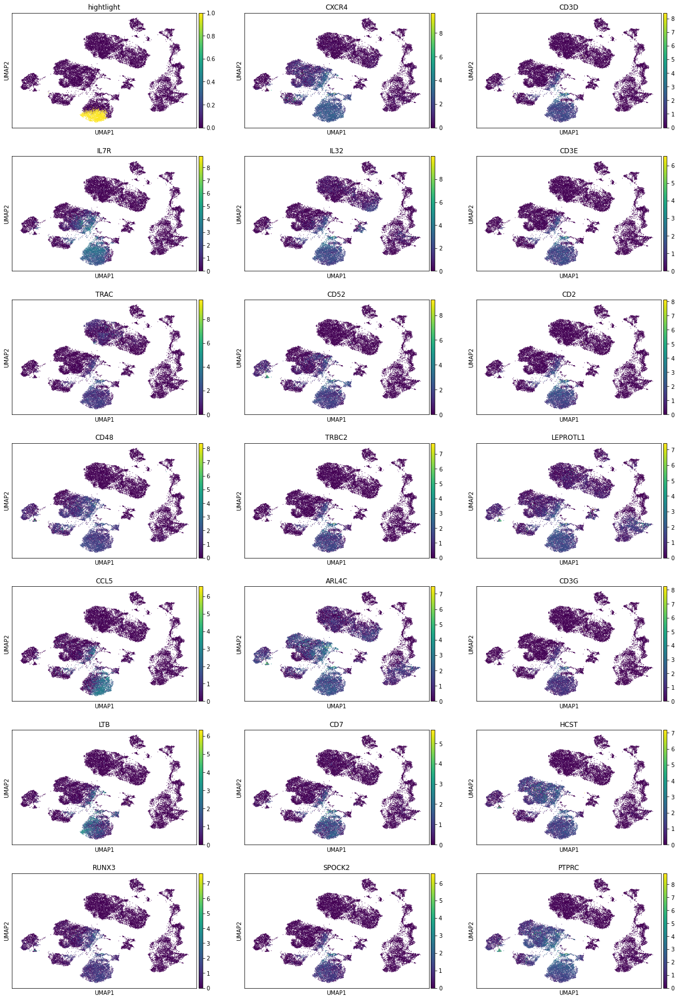

<IPython.core.display.Javascript object>

In [325]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


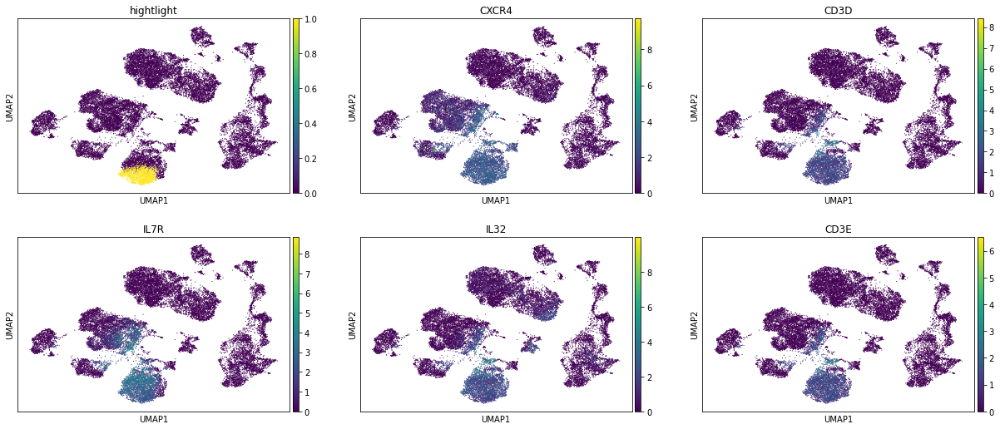

1


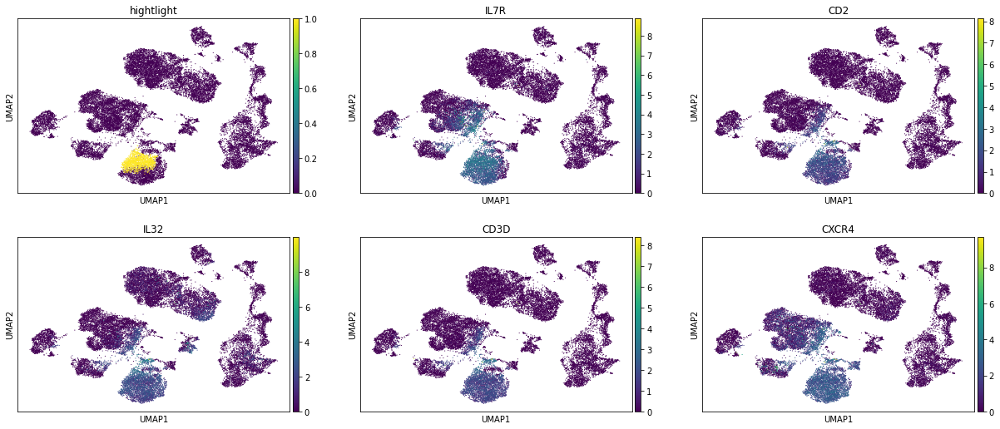

2


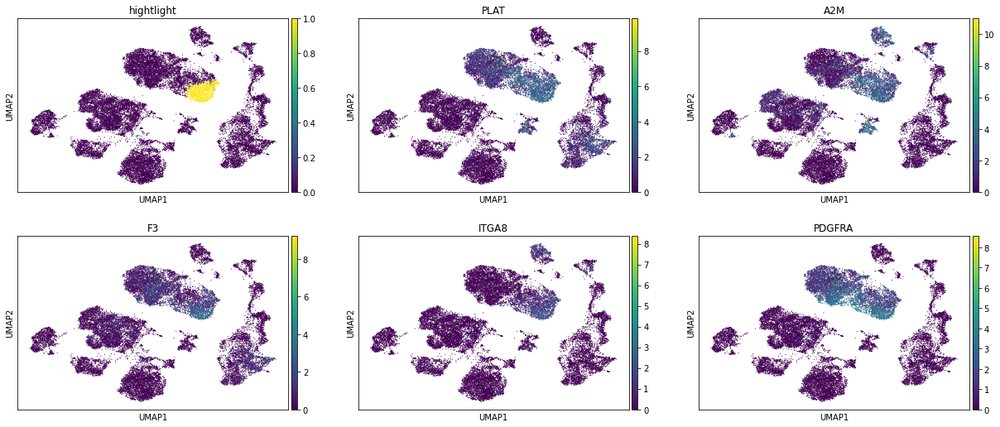

3


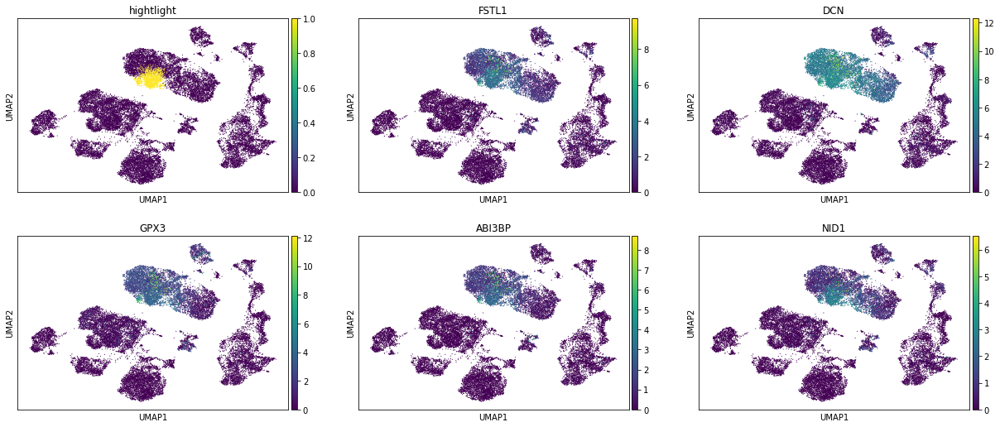

4


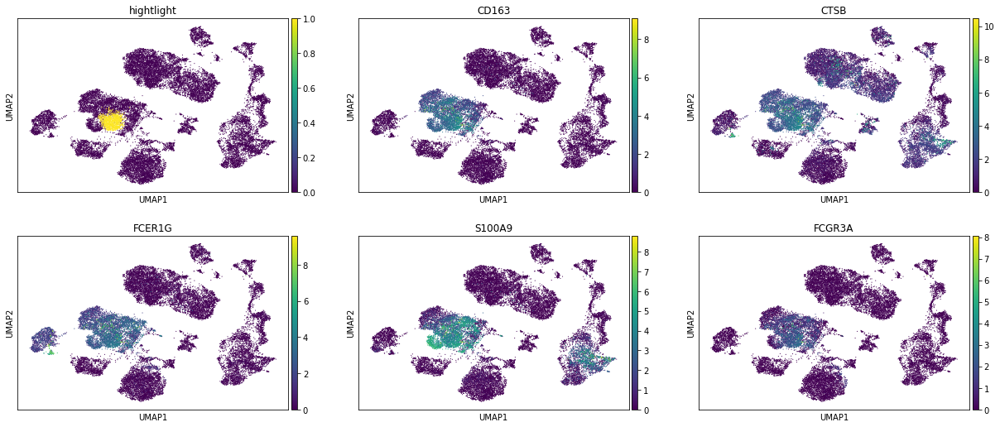

5


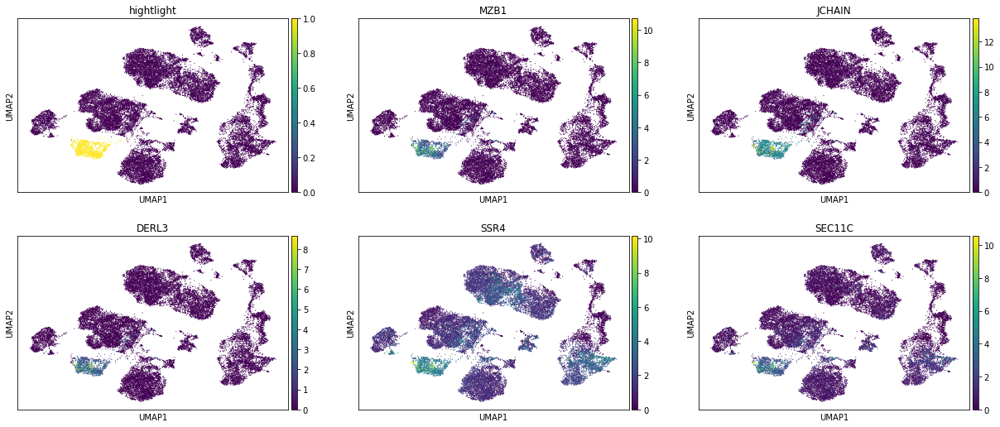

6


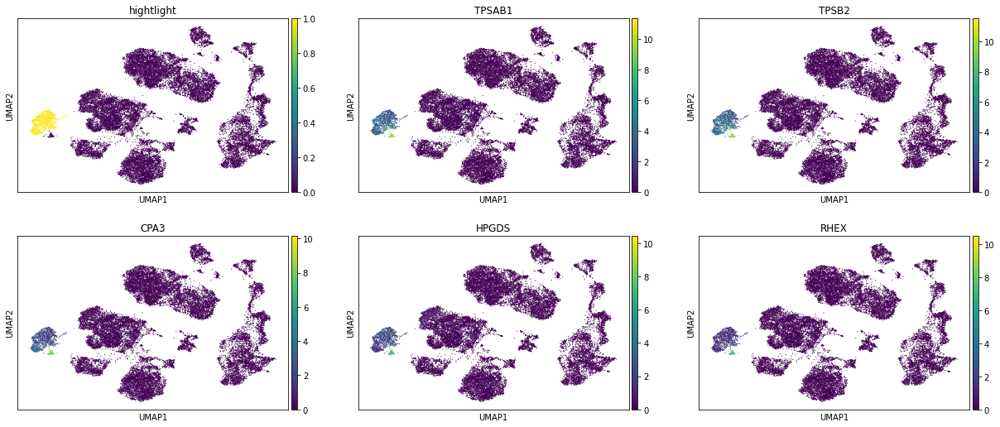

7


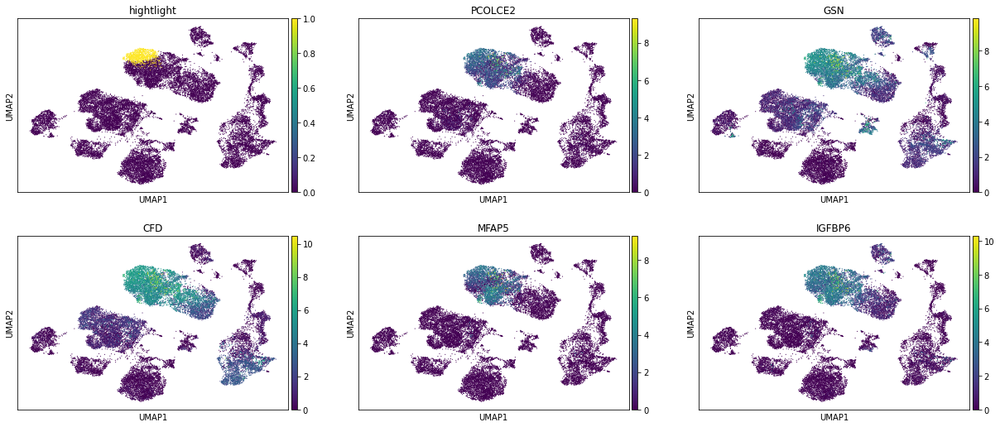

8


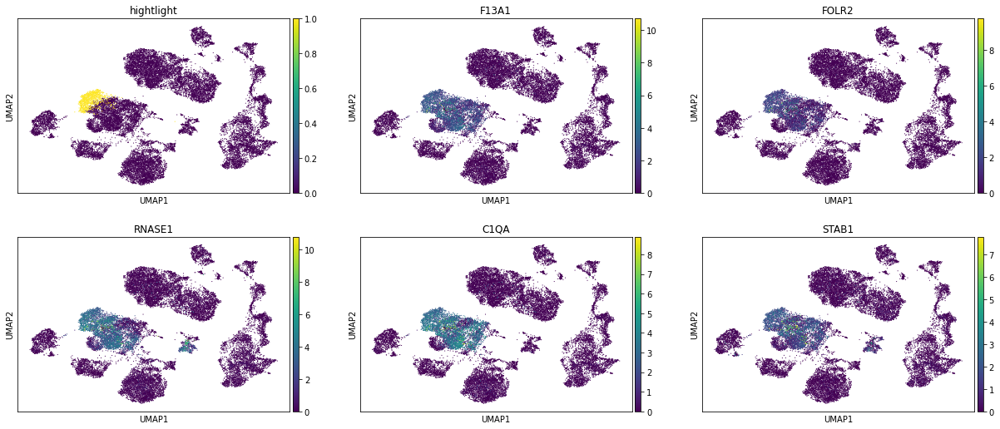

9


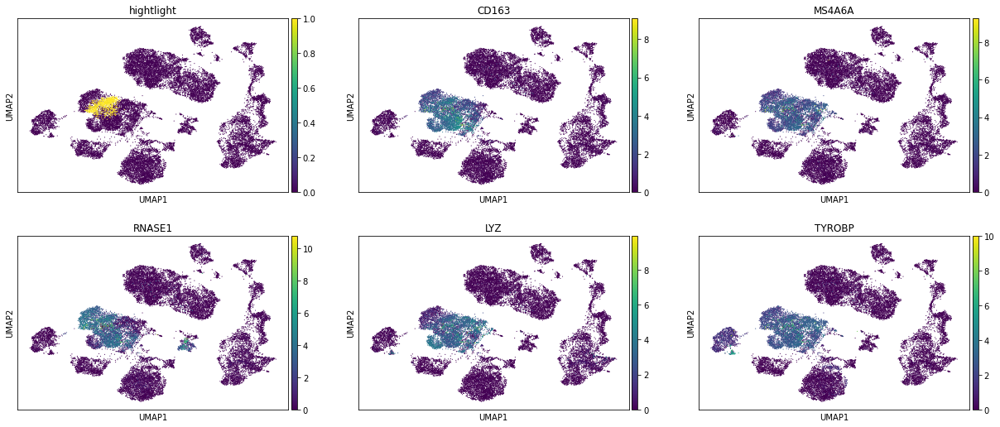

10


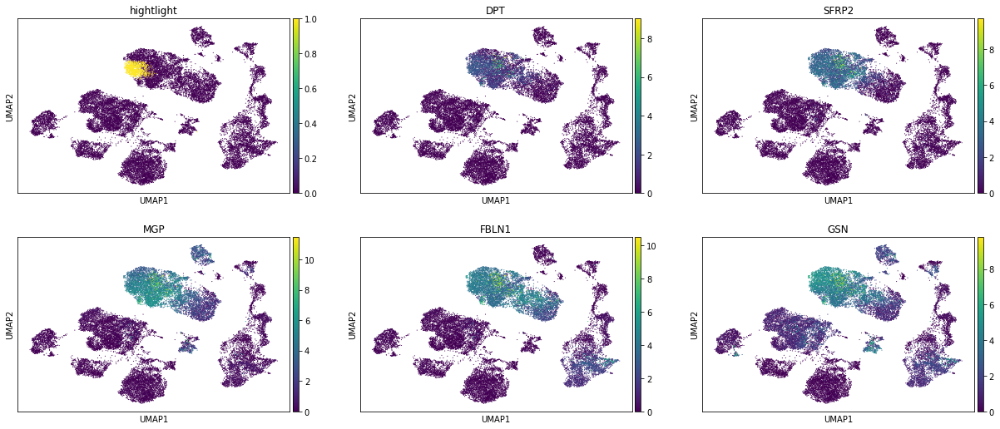

11


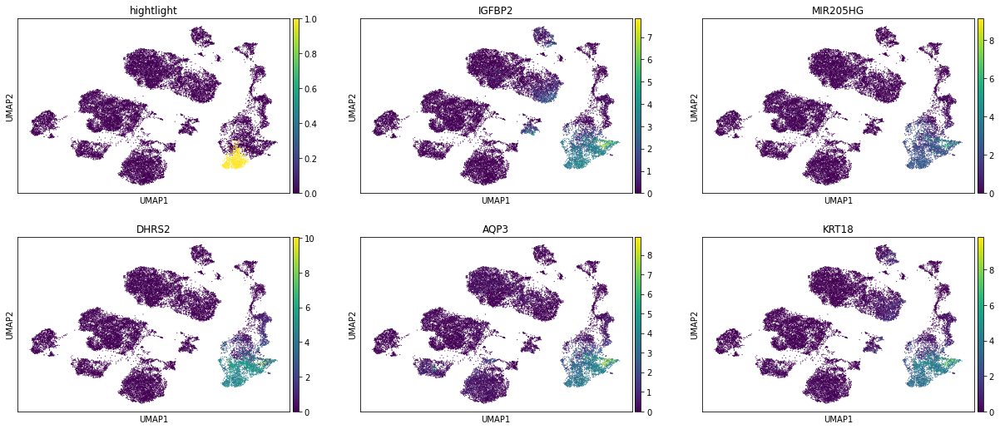

12


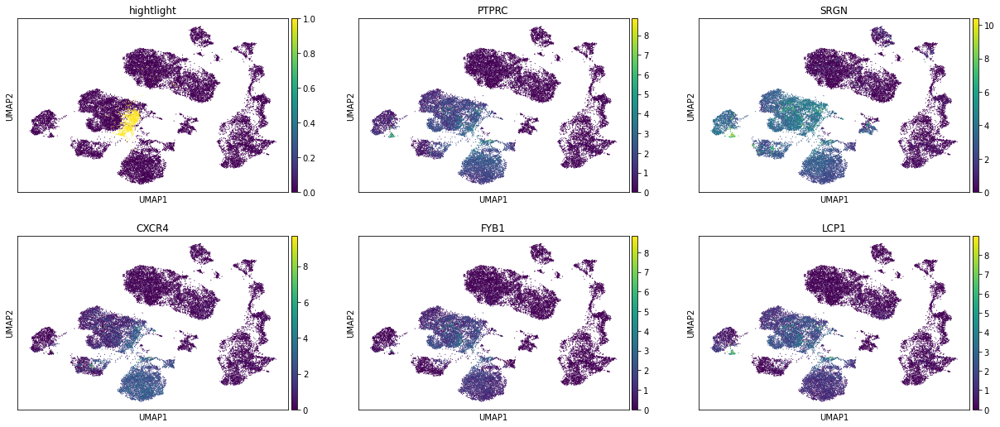

13


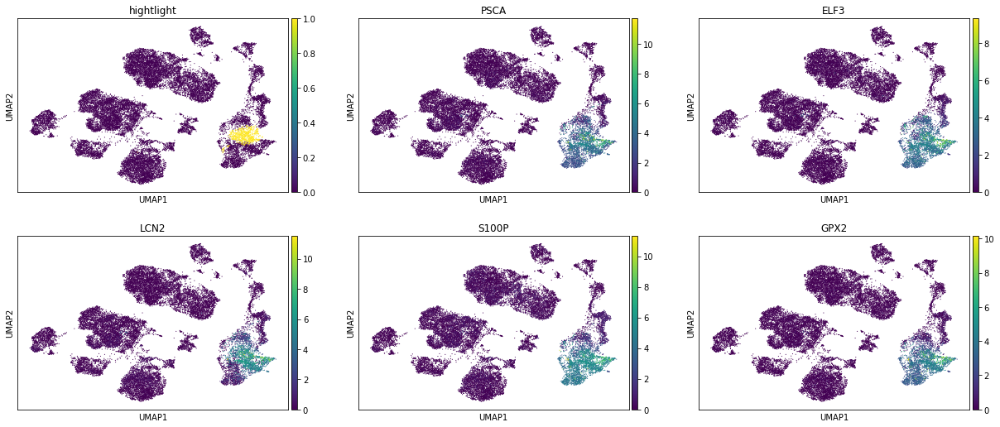

14


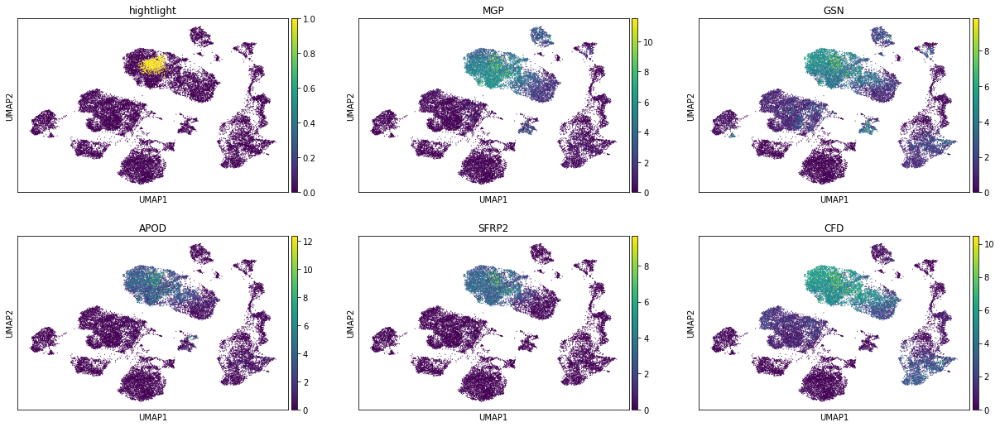

15


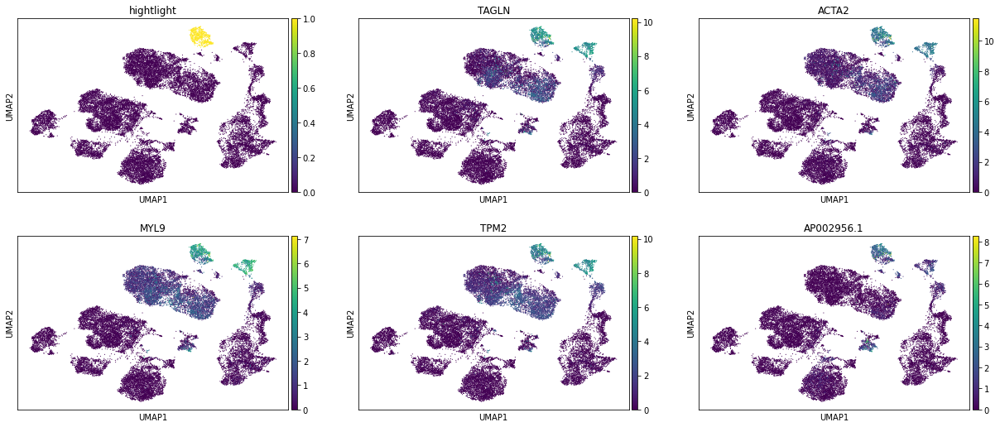

16


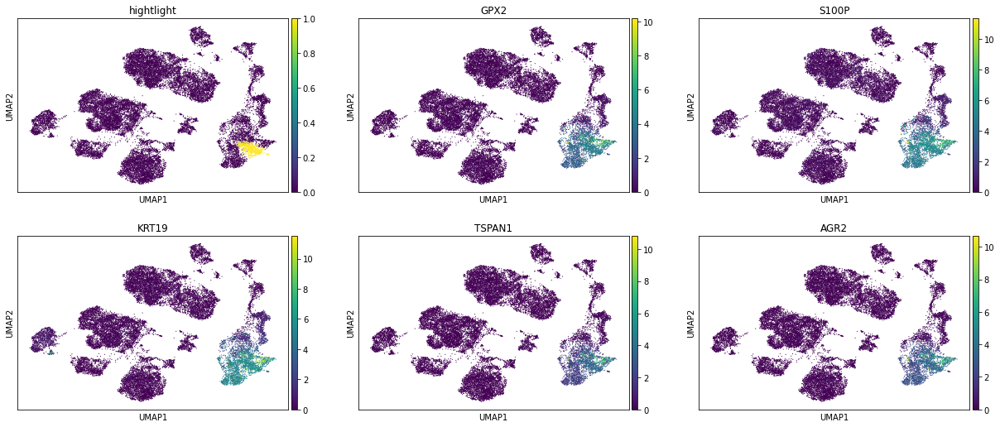

17


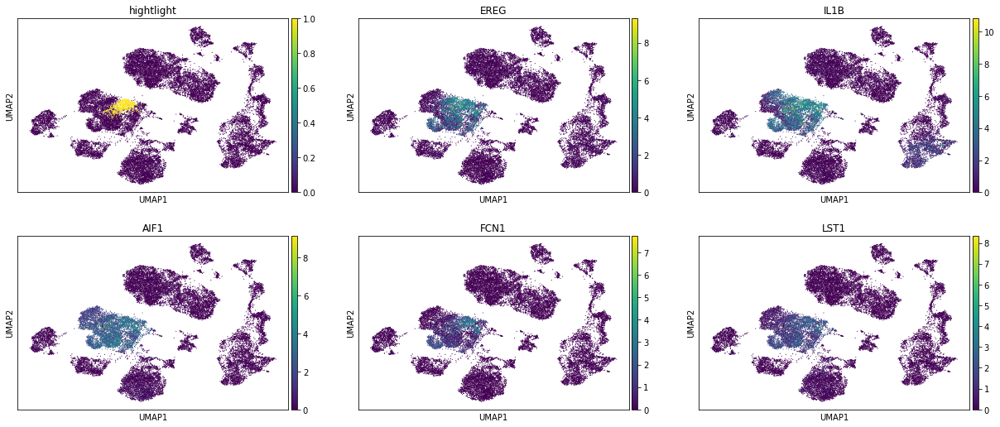

18


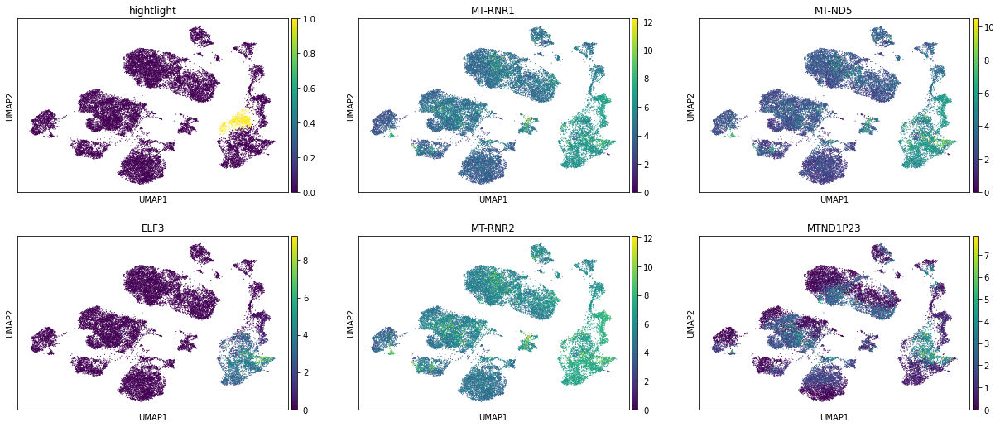

19


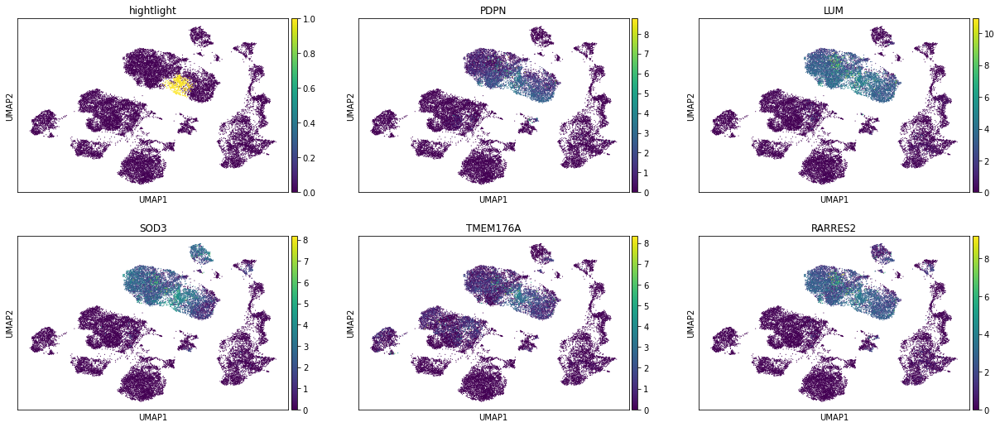

20


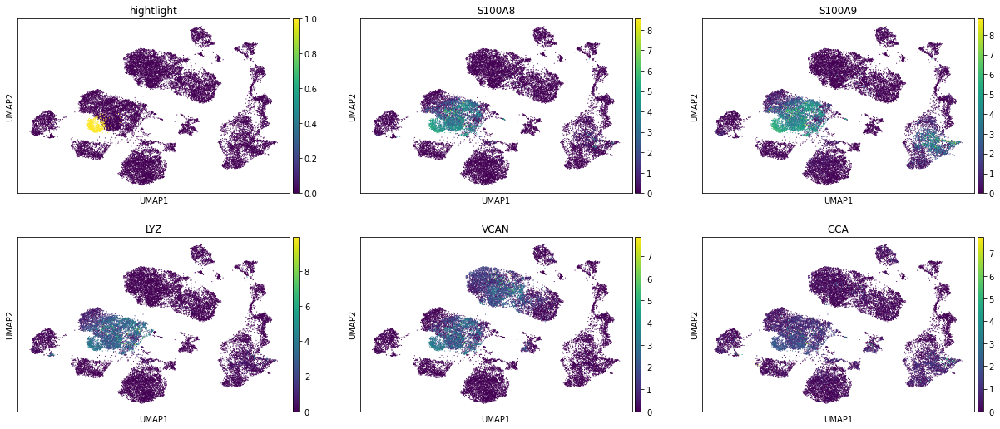

21


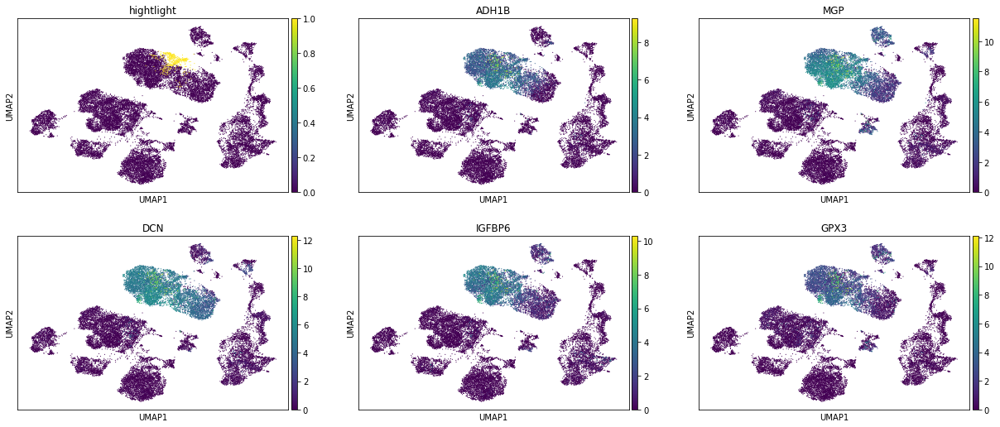

22


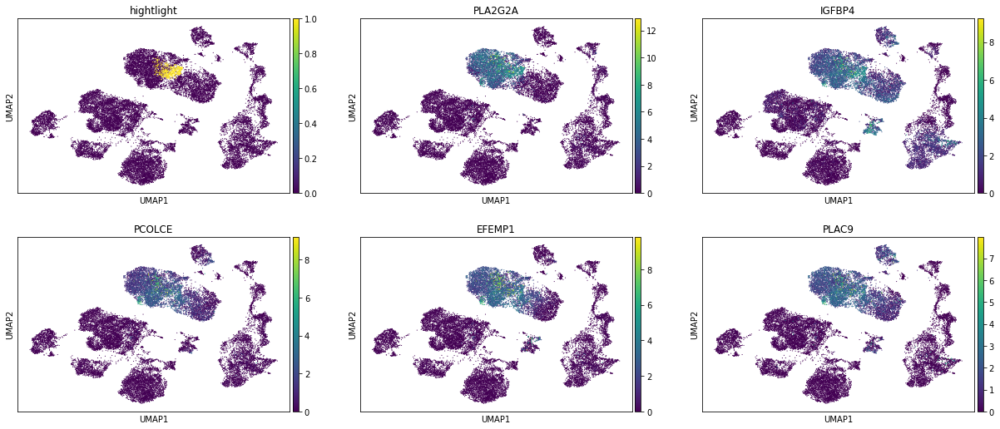

23


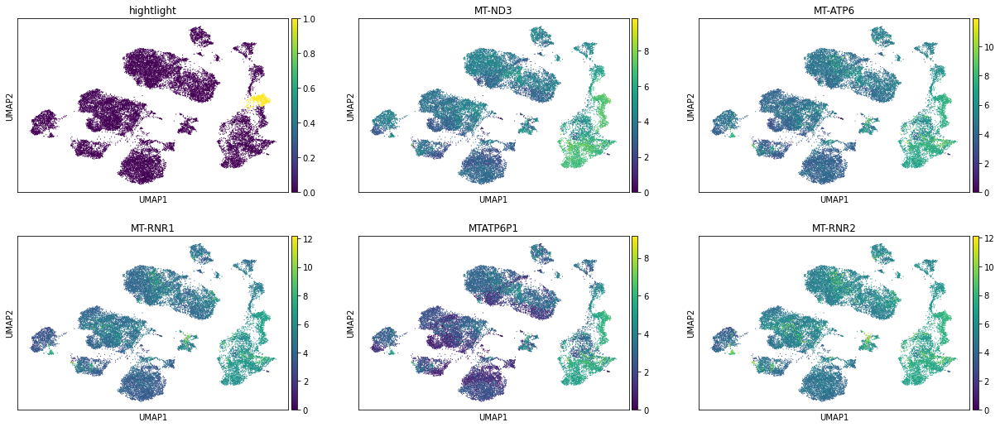

24


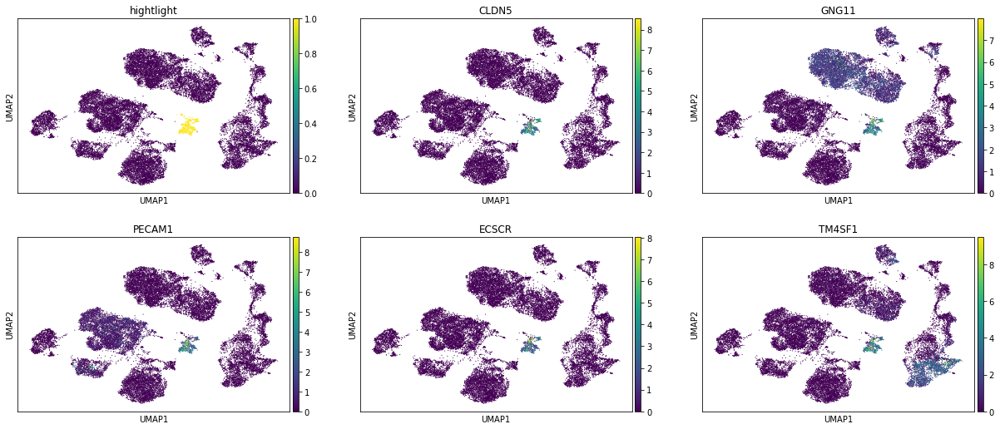

25


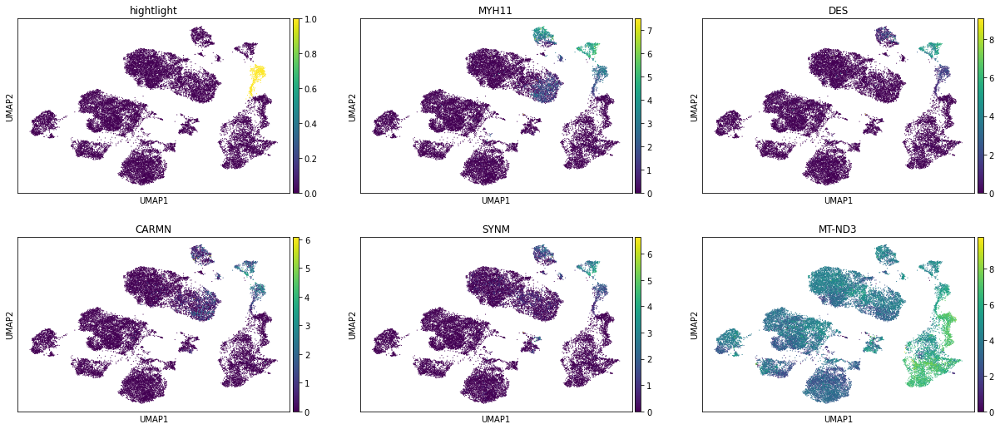

26


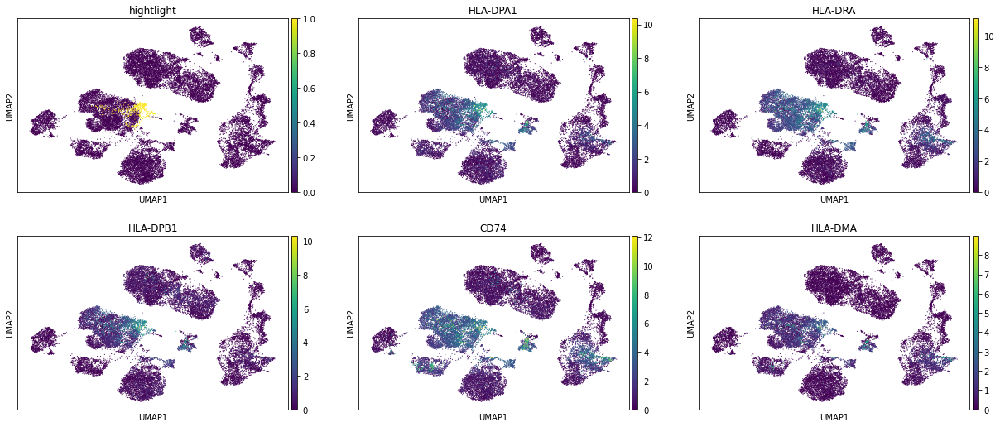

27


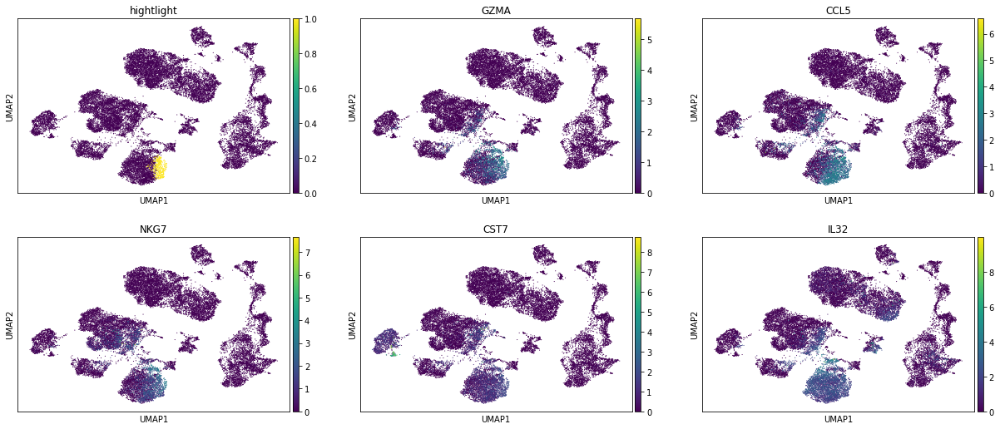

28


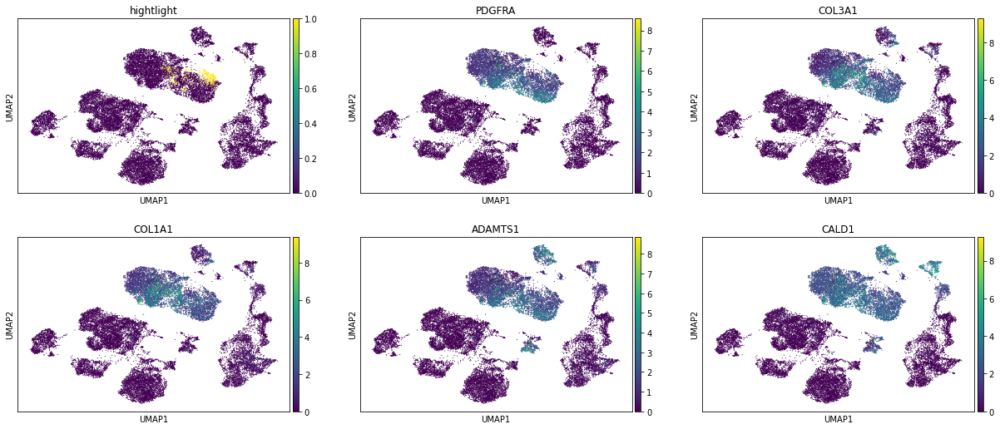

29


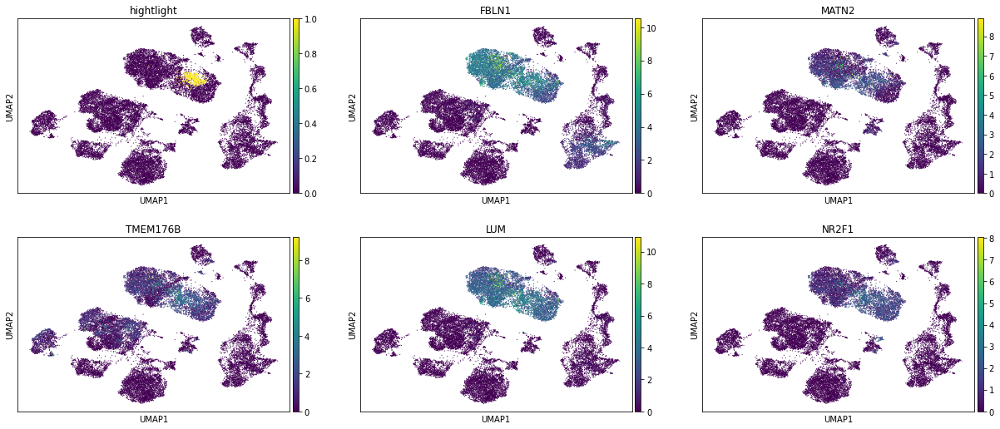

30


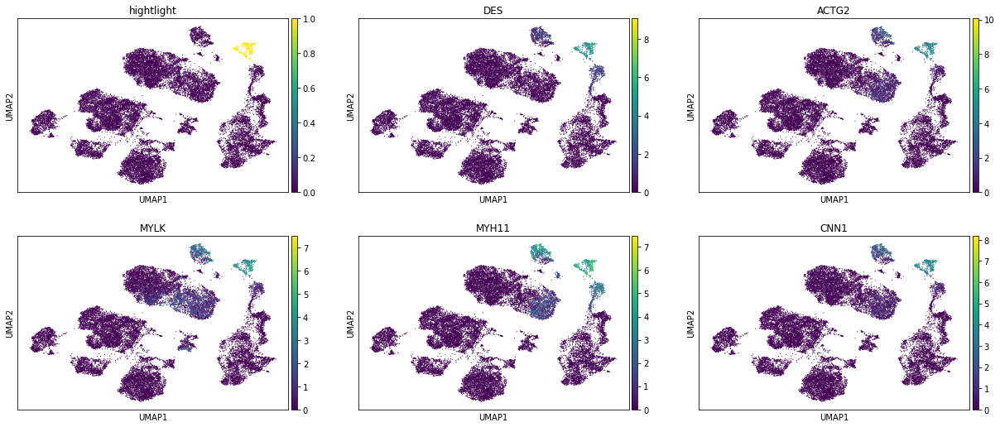

31


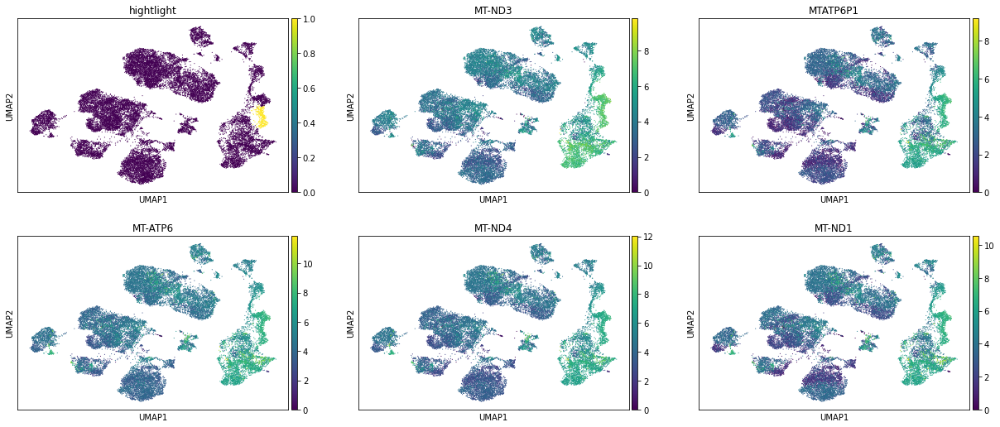

32


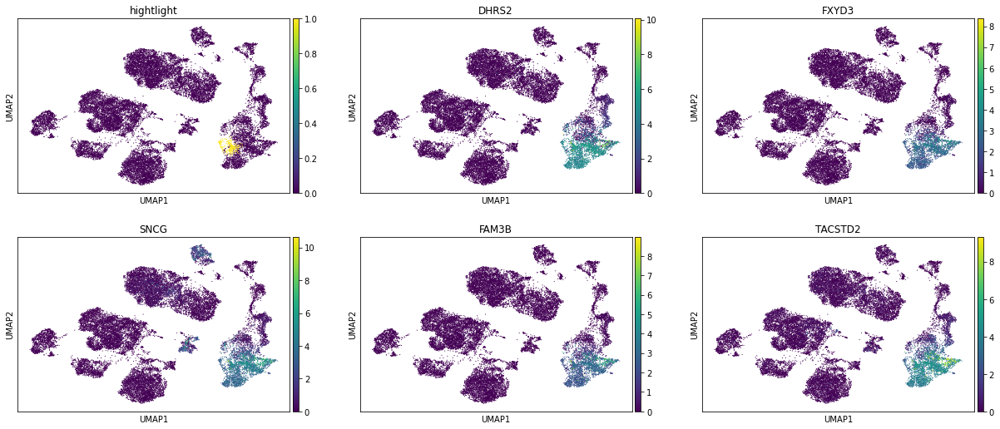

33


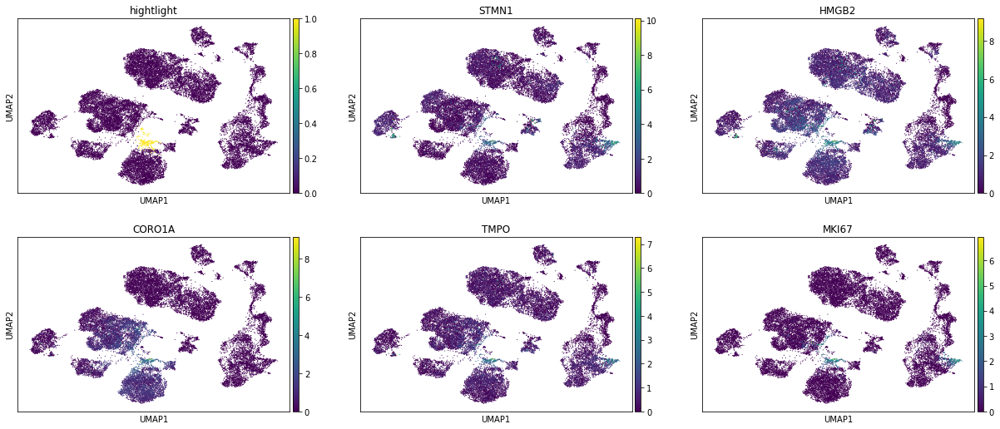

34


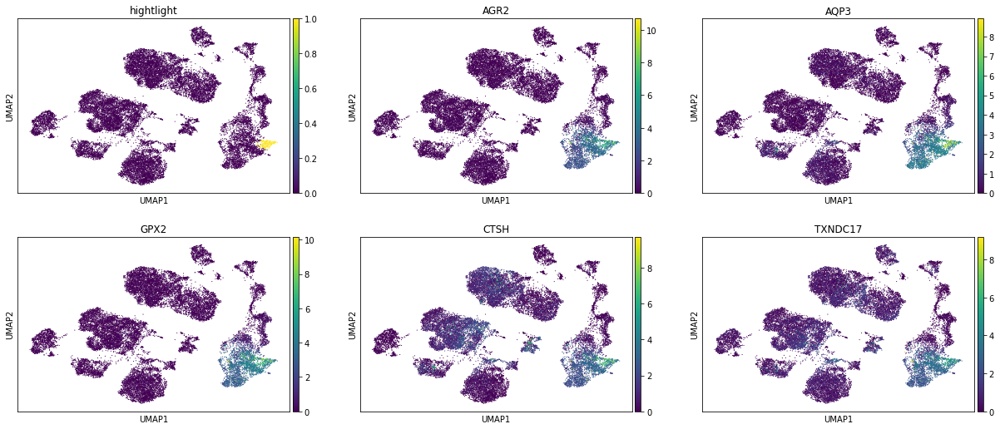

35


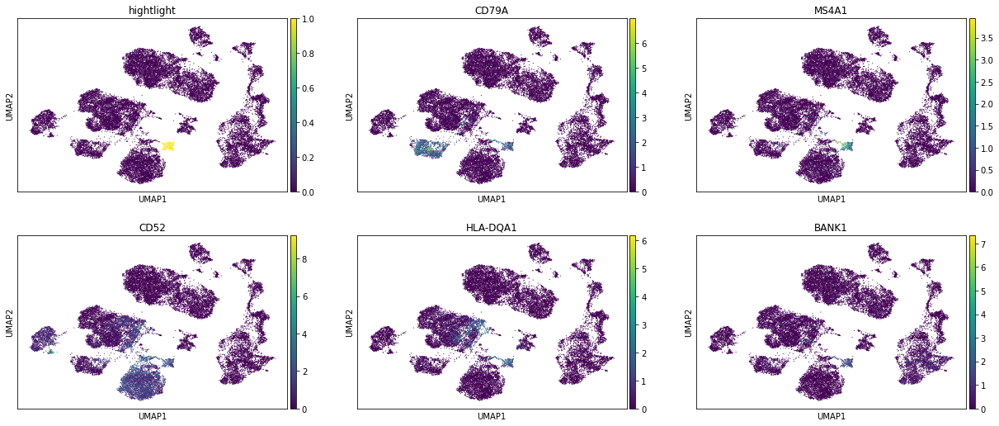

36


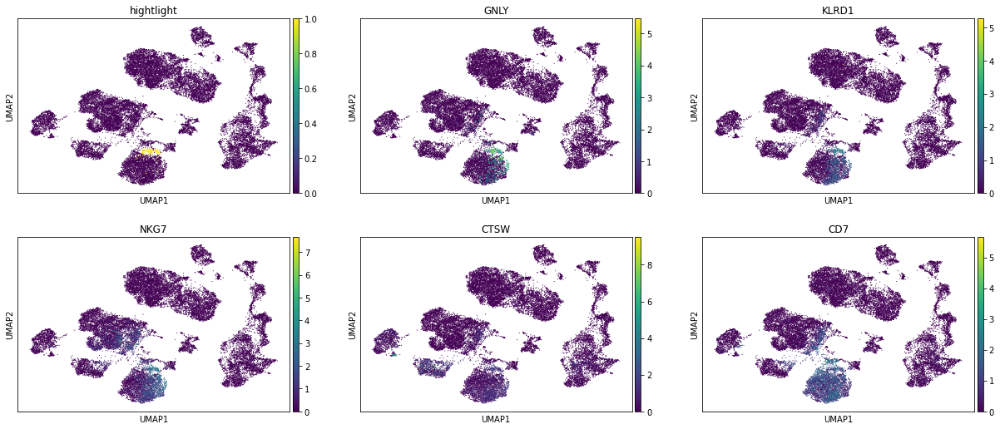

37


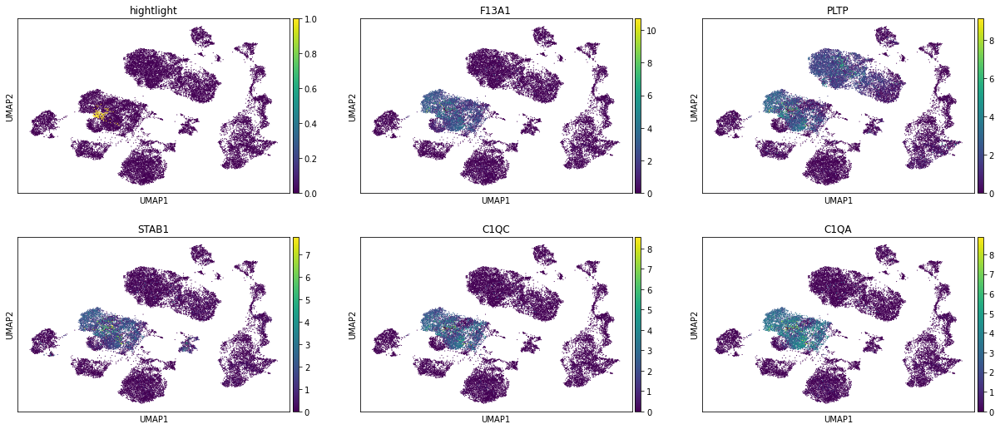

38


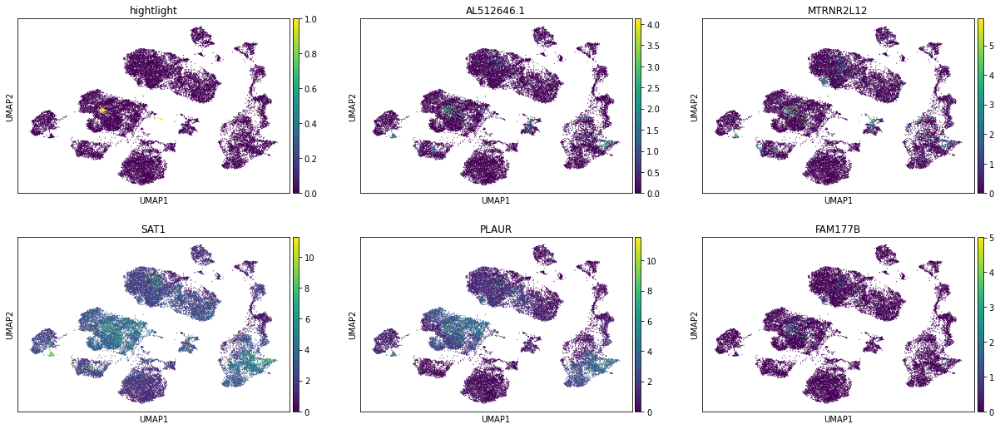

39


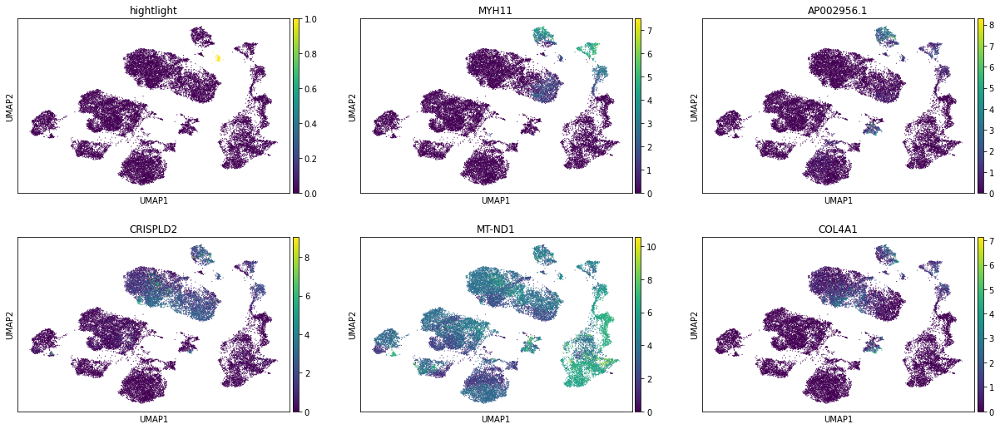

40


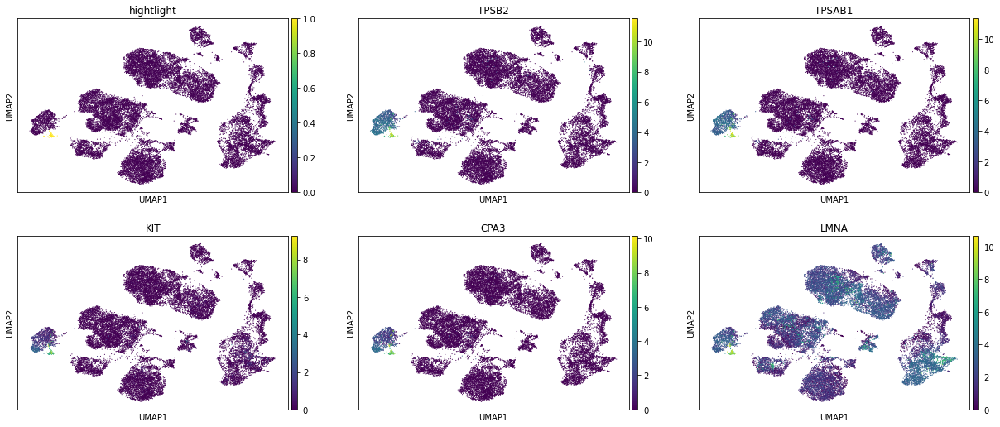

41


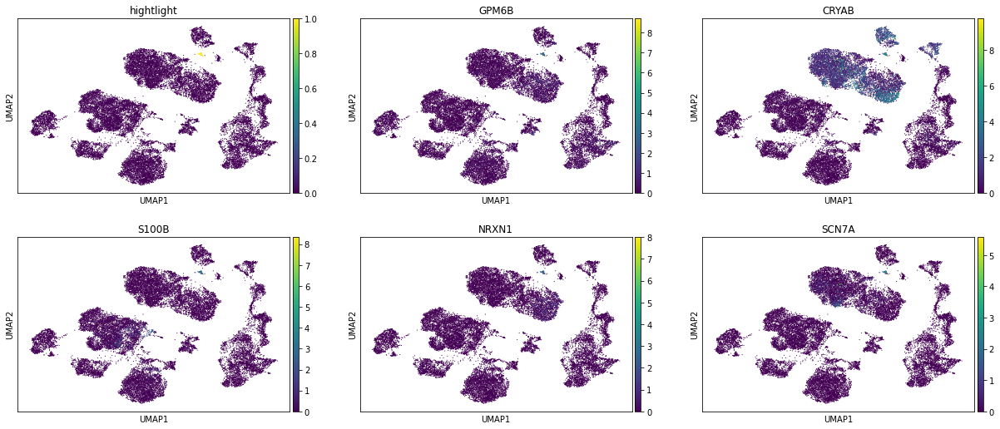

<IPython.core.display.Javascript object>

In [294]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [299]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
CXCR4,52.791164,7.575534,0.0
CD3D,50.978634,6.333284,0.0
IL7R,47.952839,7.743592,0.0
IL32,47.816380,3.756449,0.0
CD3E,46.534985,4.077493,0.0
...,...,...,...
SOD2,-41.716660,-48.130619,0.0
FTL,-42.618778,-704.118591,0.0
PSAP,-42.932926,-53.667564,0.0
CST3,-44.565929,-61.197937,0.0


<IPython.core.display.Javascript object>

# read in cell ontology 

In [342]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



<IPython.core.display.Javascript object>

You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [ ]:
celltype_dict['T cell']

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [358]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-negative, CD8-negative type I NK T cell',
 'CD4-intermediate, CD8-positive double-positive thymocyte',
 'CD4-positive, CD8-intermediate double-positive thymocyte',
 'CD4-positive, CXCR3-negative, CCR6-negative, alpha-beta T cell',
 'CD4-positive, CD25-positive, alpha-beta regulatory T cell',
 'CD4-positive, alpha-beta thymocyte',
 'CD24-positive, CD4 single-positive thymocyte',
 'CD4-positive type I NK T cell secreting interferon-gamma',
 'CD69-positive, CD4-positive single-positive thymocyte',
 'effector memory CD4-positive, alpha-beta T cell',
 'activated CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell, human',
 'CD4-positive, alpha-beta cytotoxic T cell',
 'CD2-positive, CD5-positive, CD44-positive alpha-beta intraepithelial T cell',
 'activated CD4-positive, alpha-beta T cell',
 'naive thymus-derived CD4-positive, alpha-beta T cell',
 'activated CD4-negative, CD8-negative type I NK T cell',
 'mature CD4 single-positive thymocyte',
 'activated CD4-posi

<IPython.core.display.Javascript object>

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [343]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

<IPython.core.display.Javascript object>

This cell will automatically replace the leiden cluster names with cell type annotations

In [361]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,52.791164,50.978634,47.952839,47.816380
log fold change,7.575534,6.333284,7.743592,3.756449
adjusted pvalue,0.000000,0.000000,0.000000,0.000000


<IPython.core.display.Javascript object>

# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



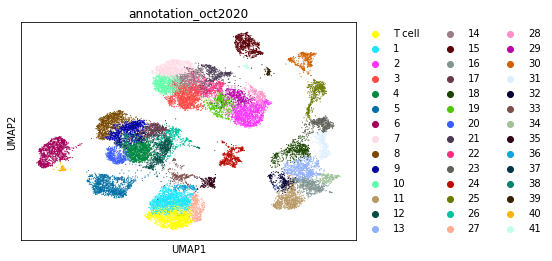

<IPython.core.display.Javascript object>

In [362]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# manually create mapping between cell type and compartment (this is just an example)

In [366]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

<IPython.core.display.Javascript object>

This cell will automatically replace the leiden cluster names with cell type annotations

In [367]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

<IPython.core.display.Javascript object>

# Visualize the results of the new compartment splitting

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



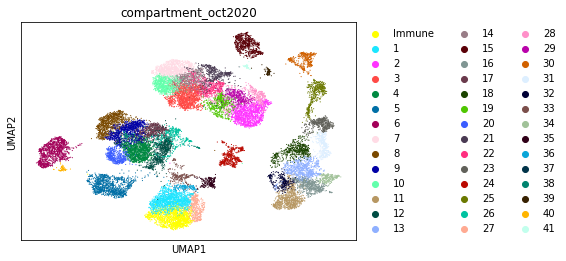

<IPython.core.display.Javascript object>

In [368]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [ ]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)